# Generating Learning Maps

Learning Maps now need to be generated and then evaluated on the range of shapes.

In [2]:
import sys
import logging
import json
import networkx as nx
import traceback
from generate_methods import GenerateLearningJourneys
import matplotlib.pyplot as plt
import requests
import pandas as pd
import numpy as np
import networkx as nx

from networkx.algorithms.community import louvain_communities, modularity
from networkx.algorithms.community.label_propagation import label_propagation_communities
from graph_tools import compare_graphs, plot_single_graph

from app import SUBECT_PREFIX
import subprocess
import platform
import os
import seaborn as sns
from datetime import datetime, timedelta


system = platform.system()

# Configure the root logger
logging.basicConfig(
    level=logging.INFO,
    format='%(asctime)s - %(name)s - %(levelname)s - %(message)s',
    handlers=[logging.StreamHandler(sys.stdout)]
)

logger = logging.getLogger(__name__)


def run_scraper(start_link):
    venv_location = '../../../../.venv/bin/python'
    if system == "Windows":
        print("Warning: running on Windows")
        venv_location = '../../../../.venv/Scripts/python'
    script_path = os.path.abspath("app.py")
    print("subprocess started")
    subprocess.call([venv_location, script_path, start_link])
    print("subprocess finished")

In [3]:

def get_page_views(title, days=30):
    base_url = "https://wikimedia.org/api/rest_v1/metrics/pageviews/per-article"
    project = "en.wikipedia.org"
    access = "all-access"
    agent = "user"
    
    end_date = datetime.now()
    start_date = end_date - timedelta(days=days)
    start = start_date.strftime("%Y%m%d00")
    end = end_date.strftime("%Y%m%d00")
    
    headers = {
        'User-Agent': 'MyWikipediaBot/1.0 (https://www.example.com/; myemail@example.com)'
    }
    url = f"{base_url}/{project}/{access}/{agent}/{title}/daily/{start}/{end}"
    
    try:
        logger.debug(f"Attempting request for {url}")
        response = requests.get(url, headers=headers)
        response.raise_for_status()
        data = response.json()
        
        daily_views = {item['timestamp']: item['views'] for item in data['items']}
        total_views = sum(daily_views.values())
        
        return total_views
    
    except requests.exceptions.RequestException as e:
        logger.warning(f"An error occurred: {e}")
        logger.warning(f"Failed to parse {url=}")
        return None


Using cached results


/Users/andrewevans/Documents/Data Science MSc/Year 3/learning-map-analysis/.venv/lib/python3.12/site-packages/networkx/readwrite/json_graph/node_link.py:287: FutureWarning: 
The default value will be changed to `edges="edges" in NetworkX 3.6.

To make this warning go away, explicitly set the edges kwarg, e.g.:

  nx.node_link_graph(data, edges="links") to preserve current behavior, or
  nx.node_link_graph(data, edges="edges") for forward compatibility.
  warnings.warn(


Using cached results
Using cached results
Using cached results
subprocess started


2024-12-01 08:31:12 [scrapy.utils.log] INFO: Scrapy 2.12.0 started (bot: scrapybot)
2024-12-01 08:31:12 [scrapy.utils.log] INFO: Versions: lxml 5.3.0.0, libxml2 2.12.9, cssselect 1.2.0, parsel 1.9.1, w3lib 2.2.1, Twisted 24.10.0, Python 3.12.7 (main, Nov 29 2024, 16:19:57) [Clang 14.0.3 (clang-1403.0.22.14.1)], pyOpenSSL 24.3.0 (OpenSSL 3.4.0 22 Oct 2024), cryptography 44.0.0, Platform macOS-13.4-arm64-arm-64bit
2024-12-01 08:31:12 [scrapy.addons] INFO: Enabled addons:
[]
2024-12-01 08:31:12 [scrapy.extensions.telnet] INFO: Telnet Password: 6a0386634b8c3b30
2024-12-01 08:31:12 [root] INFO: StatsCollectorExtension.from_crawler called
2024-12-01 08:31:12 [root] INFO: StatsCollectorExtension initialized
2024-12-01 08:31:12 [scrapy.middleware] INFO: Enabled extensions:
['scrapy.extensions.corestats.CoreStats',
 'scrapy.extensions.telnet.TelnetConsole',
 'scrapy.extensions.memusage.MemoryUsage',
 'scrapy.extensions.logstats.LogStats',
 'wikipedia_crawler.extensions.stats_collector.StatsColl

Writing data to JSON file...
Written successfully
Failed to save to static website folder
Error: [Errno 2] No such file or directory: 'static/Aedes_albopictus_visualisation_data_graph.json'
Data written to JSON file.
Top nodes by <function pagerank at 0x11ace5300>:
Node: https://en.wikipedia.org/wiki/Mosquito, <function pagerank at 0x11ace5300>: 0.00082323713870613
Node: https://en.wikipedia.org/wiki/Species, <function pagerank at 0x11ace5300>: 0.0008114724513369753
Node: https://en.wikipedia.org/wiki/Genus, <function pagerank at 0x11ace5300>: 0.0006805062202301243
Node: https://en.wikipedia.org/wiki/Family_(biology), <function pagerank at 0x11ace5300>: 0.0006384706240377865
Node: https://en.wikipedia.org/wiki/Virus, <function pagerank at 0x11ace5300>: 0.0006268740556730763
Node: https://en.wikipedia.org/wiki/Host_(biology), <function pagerank at 0x11ace5300>: 0.0005996120948504085
Node: https://en.wikipedia.org/wiki/Latin, <function pagerank at 0x11ace5300>: 0.0005785206543024499
Node

/Users/andrewevans/Documents/Data Science MSc/Year 3/learning-map-analysis/.venv/lib/python3.12/site-packages/networkx/drawing/nx_pylab.py:315: UserWarning: 

The arrowsize keyword argument is not applicable when drawing edges
with LineCollection.

To make this warning go away, either specify `arrows=True` to
force FancyArrowPatches or use the default values.
Note that using FancyArrowPatches may be slow for large graphs.

  draw_networkx_edges(G, pos, arrows=arrows, **edge_kwds)
/Users/andrewevans/Documents/Data Science MSc/Year 3/learning-map-analysis/.venv/lib/python3.12/site-packages/networkx/readwrite/json_graph/node_link.py:287: FutureWarning: 
The default value will be changed to `edges="edges" in NetworkX 3.6.

To make this warning go away, explicitly set the edges kwarg, e.g.:

  nx.node_link_graph(data, edges="links") to preserve current behavior, or
  nx.node_link_graph(data, edges="edges") for forward compatibility.
  warnings.warn(
/Users/andrewevans/Documents/Data Science

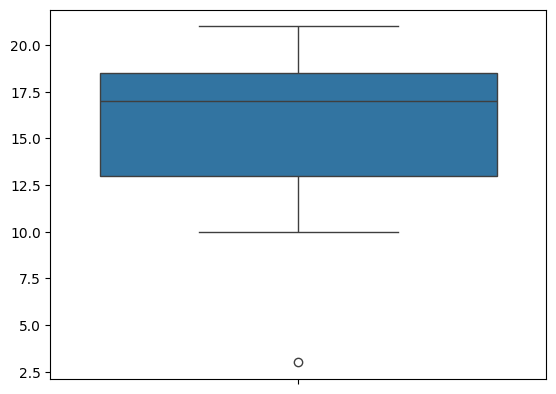

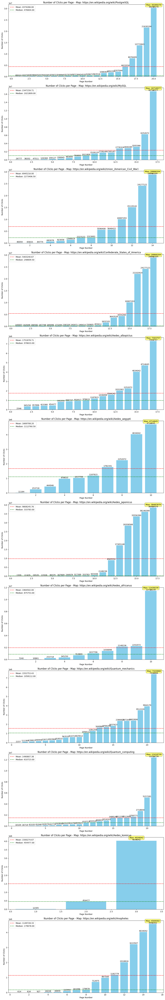

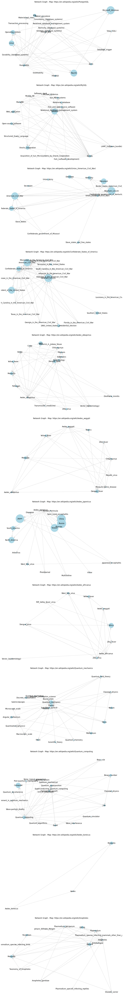

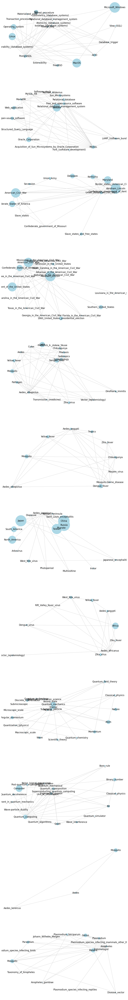

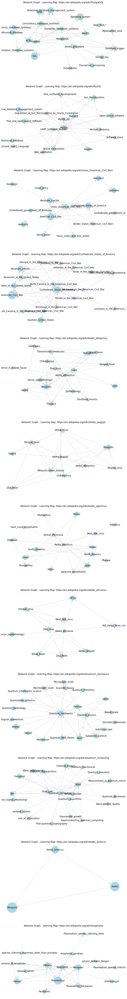

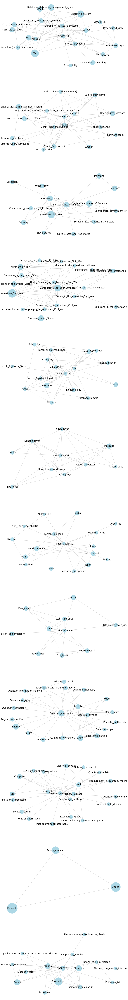

Using cached results
2024-12-01 08:35:46,138 - __main__ - WARNING - An error occurred: 404 Client Error: Not Found for url: https://wikimedia.org/api/rest_v1/metrics/pageviews/per-article/en.wikipedia.org/all-access/user/SQL/PSM/daily/2019120300/2024120100
2024-12-01 08:35:46,143 - __main__ - WARNING - Failed to parse url='https://wikimedia.org/api/rest_v1/metrics/pageviews/per-article/en.wikipedia.org/all-access/user/SQL/PSM/daily/2019120300/2024120100'
Using cached results
Using cached results
Using cached results
Using cached results
Using cached results
Using cached results
Using cached results
Using cached results
Using cached results
Using cached results
Using cached results
2024-12-01 08:38:30,931 - __main__ - WARNING - Node of size None was encountered
2024-12-01 08:38:30,932 - __main__ - WARNING - Converting to zero


/Users/andrewevans/Documents/Data Science MSc/Year 3/learning-map-analysis/.venv/lib/python3.12/site-packages/networkx/drawing/nx_pylab.py:315: UserWarning: 

The arrowsize keyword argument is not applicable when drawing edges
with LineCollection.

To make this warning go away, either specify `arrows=True` to
force FancyArrowPatches or use the default values.
Note that using FancyArrowPatches may be slow for large graphs.

  draw_networkx_edges(G, pos, arrows=arrows, **edge_kwds)
/Users/andrewevans/Documents/Data Science MSc/Year 3/learning-map-analysis/.venv/lib/python3.12/site-packages/networkx/readwrite/json_graph/node_link.py:287: FutureWarning: 
The default value will be changed to `edges="edges" in NetworkX 3.6.

To make this warning go away, explicitly set the edges kwarg, e.g.:

  nx.node_link_graph(data, edges="links") to preserve current behavior, or
  nx.node_link_graph(data, edges="edges") for forward compatibility.
  warnings.warn(
/Users/andrewevans/Documents/Data Science

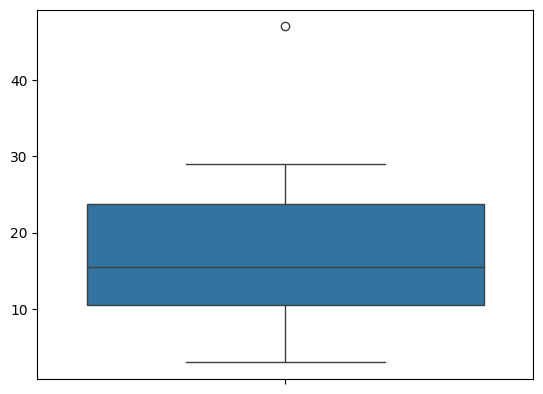

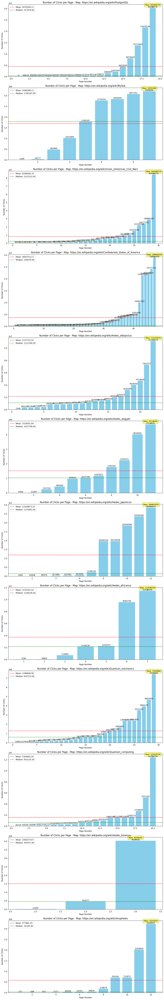

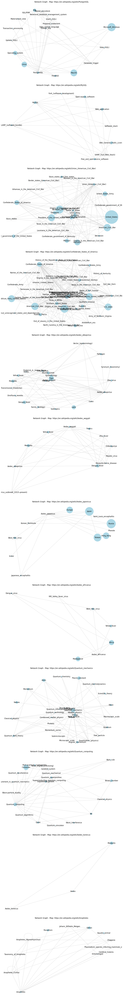

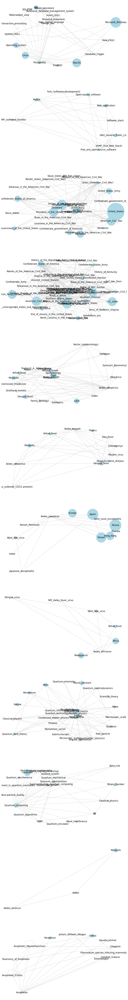

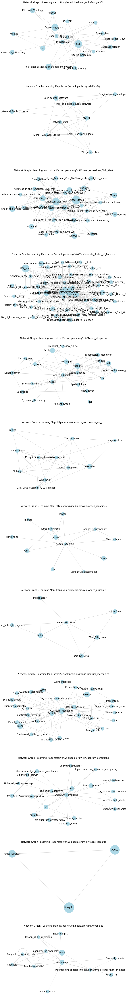

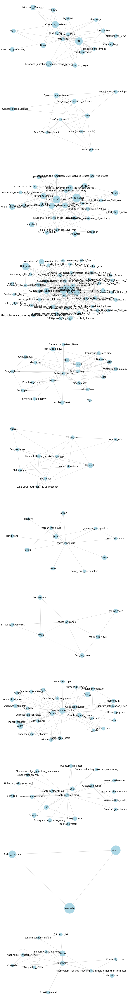

Using cached results
Using cached results
Using cached results
Using cached results
Using cached results
Using cached results
Using cached results
Using cached results
Using cached results
Using cached results
Using cached results
Using cached results


/Users/andrewevans/Documents/Data Science MSc/Year 3/learning-map-analysis/.venv/lib/python3.12/site-packages/networkx/drawing/nx_pylab.py:315: UserWarning: 

The arrowsize keyword argument is not applicable when drawing edges
with LineCollection.

To make this warning go away, either specify `arrows=True` to
force FancyArrowPatches or use the default values.
Note that using FancyArrowPatches may be slow for large graphs.

  draw_networkx_edges(G, pos, arrows=arrows, **edge_kwds)
/Users/andrewevans/Documents/Data Science MSc/Year 3/learning-map-analysis/.venv/lib/python3.12/site-packages/networkx/readwrite/json_graph/node_link.py:287: FutureWarning: 
The default value will be changed to `edges="edges" in NetworkX 3.6.

To make this warning go away, explicitly set the edges kwarg, e.g.:

  nx.node_link_graph(data, edges="links") to preserve current behavior, or
  nx.node_link_graph(data, edges="edges") for forward compatibility.
  warnings.warn(
/Users/andrewevans/Documents/Data Science

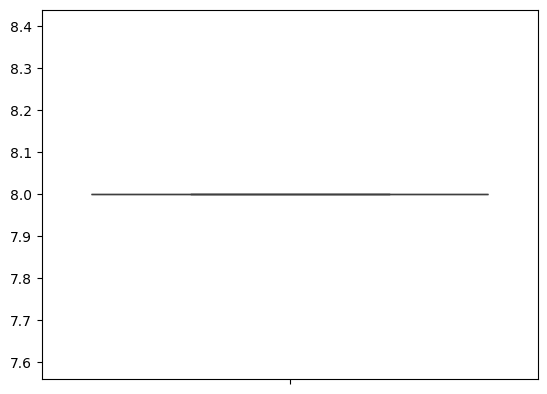

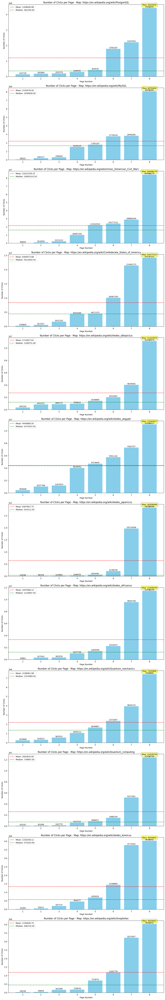

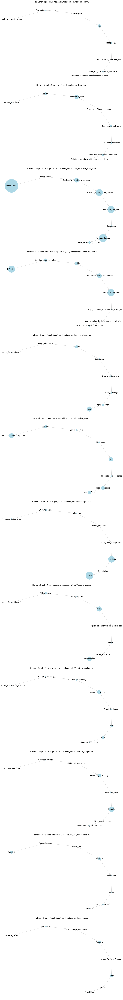

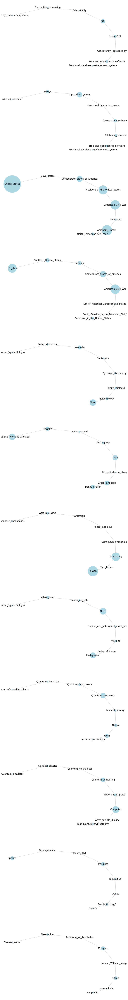

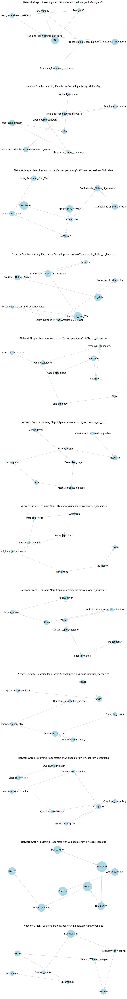

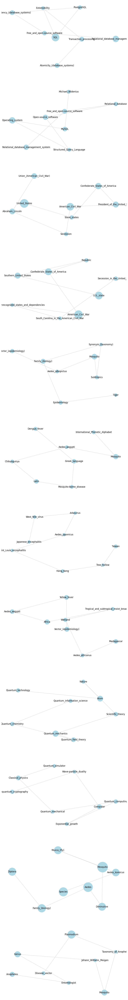

In [4]:

links = [
    "https://en.wikipedia.org/wiki/PostgreSQL",
    "https://en.wikipedia.org/wiki/MySQL",
    "https://en.wikipedia.org/wiki/Union_(American_Civil_War)",
    "https://en.wikipedia.org/wiki/Confederate_States_of_America",
    "https://en.wikipedia.org/wiki/Aedes_albopictus",
    "https://en.wikipedia.org/wiki/Aedes_aegypti",
    "https://en.wikipedia.org/wiki/Aedes_japonicus",
    "https://en.wikipedia.org/wiki/Aedes_africanus",
    "https://en.wikipedia.org/wiki/Quantum_mechanics",
    "https://en.wikipedia.org/wiki/Quantum_computing",
    "https://en.wikipedia.org/wiki/Aedes_koreicus",
    "https://en.wikipedia.org/wiki/Anopheles"
]

DATA = {
    louvain_communities: "directed",
    label_propagation_communities: "undirected",
    nx.pagerank: "centrality",
}

# Captures the amount of nodes in the graph, the indexes represent the max distance away
size_of_methods = {
    "louvain_communities": [],
    "label_propagation_communities": [],
}

graph_data_comparison = {}

for method, thing in DATA.items():
    count = []
    counted_learning_journeys = {}
    sub_graphs = {}

    for counter, link in enumerate(links):
        # Commenting out for now as one learning journey is focused on
        start_link = link.replace(f"https://{SUBECT_PREFIX}.wikipedia.org/wiki/", "")
        if not os.path.exists(f'{start_link}_visualisation_data_graph.json'):
            run_scraper(start_link)
        else:
            print("Using cached results")
        with open(f'{start_link}_visualisation_data_graph.json', 'r') as f:
            network_data = json.load(f)
        graph = nx.node_link_graph(network_data)
        try:
            gen_learning_journeys = GenerateLearningJourneys()
            if thing == "directed":
                jouney_set, sub_graph = gen_learning_journeys.build_community_detection_journeys(graph, link, method)
                graph_data_comparison[link] = {
                    "louvain_communities": sub_graph.copy()
                }
                size_of_methods["louvain_communities"].append(sub_graph.number_of_nodes())
                glj = GenerateLearningJourneys()
                _, sub_graph_count = glj.build_community_detection_journeys(graph, link, method, max_distance=2)
                size_of_methods["louvain_communities"].append(sub_graph_count.number_of_nodes())
                glj1 = GenerateLearningJourneys()
                _, sub_graph_count = glj1.build_community_detection_journeys(graph, link, method, max_distance=3)
                size_of_methods["louvain_communities"].append(sub_graph_count.number_of_nodes())
            elif thing == "undirected":
                jouney_set, sub_graph = gen_learning_journeys.build_community_detection_journeys(graph.to_undirected(), link, method)
                size_of_methods["label_propagation_communities"].append(sub_graph.number_of_nodes())
                graph_data_comparison[link]["label_propagation_communities"] = sub_graph.copy()
                glj = GenerateLearningJourneys()
                _, sub_graph_count = glj.build_community_detection_journeys(graph.to_undirected(), link, method, max_distance=2)
                size_of_methods["label_propagation_communities"].append(sub_graph_count.number_of_nodes())
                glj1 = GenerateLearningJourneys()
                _, sub_graph_count = glj1.build_community_detection_journeys(graph.to_undirected(), link, method, max_distance=3)
                size_of_methods["label_propagation_communities"].append(sub_graph_count.number_of_nodes())
            else:
                jouney_set, sub_graph = gen_learning_journeys.build_centrality(graph, method, link)
                graph_data_comparison[link]["pagerank"] = sub_graph.copy()
            journeys = list(jouney_set)
            
            sub_graphs[start_link] = sub_graph.copy()
            
            counted_learning_journeys[link] = []
            for journey in journeys:
                journey_key = journey.replace(f"https://{SUBECT_PREFIX}.wikipedia.org/wiki/", "")
                counted_learning_journeys[link].append({
                    journey_key: get_page_views(journey_key, days=365*5)
                })
            
            count.append(len(journeys))
            # TODO plot out the journeys in detail
            # Show how long they are and give ranges of this length and cross compare back to number 9
        except Exception:
            print("Unable to parse specific learning map, reason is:")
            print(traceback.format_exc())
            
        
        
    sns.boxplot(count)

    # Determine the number of journeys
    num_journeys = len(counted_learning_journeys)

    # Create two separate figures: one for bar plots, one for network graphs
    fig_bar, axs_bar = plt.subplots(num_journeys, 1, figsize=(12, 6*num_journeys), squeeze=False)
    fig_network, axs_network = plt.subplots(num_journeys, 1, figsize=(12, 8*num_journeys), squeeze=False)
    fig_network_undirected, axs_network_undirected = plt.subplots(num_journeys, 1, figsize=(12, 8*num_journeys), squeeze=False)
    fig_pagerank, axs_pagerank = plt.subplots(num_journeys, 1, figsize=(12, 8*num_journeys), squeeze=False)
    fig_pagerank_undirected, axs_pagerank_undirected = plt.subplots(num_journeys, 1, figsize=(12, 8*num_journeys), squeeze=False)
    
    for idx, (journ, clicks) in enumerate(counted_learning_journeys.items()):
        # Clean clicks as some have nan
        click_values = list([list(i.values())[0] for i in clicks])
        sorted_clicks = sorted([i if i else 0 for i in click_values])
        # Create a DataFrame
        df = pd.DataFrame({'Page': range(1, len(sorted_clicks) + 1), 'Clicks': sorted_clicks})

        # Calculate statistics
        mean_clicks = np.mean(sorted_clicks)
        median_clicks = np.median(sorted_clicks)

        # Get the current axis for bar plot
        ax_bar = axs_bar[idx, 0]

        # Bar plot
        bars = ax_bar.bar(df['Page'], df['Clicks'], color='skyblue')

        # Add mean line
        ax_bar.axhline(y=mean_clicks, color='red', linestyle='--', label=f'Mean: {mean_clicks:.2f}')

        # Add median line
        ax_bar.axhline(y=median_clicks, color='green', linestyle='--', label=f'Median: {median_clicks:.2f}')

        # Highlight the page with maximum clicks
        max_clicks_page = df.loc[df['Clicks'].idxmax()]
        ax_bar.annotate(f'Max: {max_clicks_page["Clicks"]}', 
                    xy=(max_clicks_page['Page'], max_clicks_page['Clicks']),
                    xytext=(0, 10), textcoords='offset points',
                    ha='center', va='bottom',
                    bbox=dict(boxstyle='round,pad=0.5', fc='yellow', alpha=0.5),
                    arrowprops=dict(arrowstyle='->', connectionstyle='arc3,rad=0'))

        # Customize the plot
        ax_bar.set_title(f'Number of Clicks per Page - Map: {journ}')
        ax_bar.set_xlabel('Page Number')
        ax_bar.set_ylabel('Number of Clicks')
        ax_bar.legend()

        # Add value labels on top of each bar
        for bar in bars:
            height = bar.get_height()
            ax_bar.text(bar.get_x() + bar.get_width()/2., height,
                    f'{height}',
                    ha='center', va='bottom')
        
        # NetworkX graph
        ax_network = axs_network[idx, 0]
        ax_network_undirected = axs_network_undirected[idx, 0]
        g = sub_graphs[journ.replace(f"https://{SUBECT_PREFIX}.wikipedia.org/wiki/", "")]
        
        g = nx.relabel_nodes(g, lambda x: x.replace(f"https://{SUBECT_PREFIX}.wikipedia.org/wiki/", ""))
        
        # pos = nx.spring_layout(g, k=1.5, iterations=50)
        # pos = nx.spring_layout(g)
        pos = nx.spiral_layout(g)

        CLICK_SHRINKER_CONSTANT = 10000

        for node in clicks:
            name = list(node.keys())[0]
            size = list(node.values())[0]
            try:
                g.nodes[name]['size'] = size / CLICK_SHRINKER_CONSTANT
            except Exception:
                logger.warning(f"Node of size {size} was encountered") 
                logger.warning("Converting to zero") 
            
        node_sizes = [g.nodes[node].get('size', 0) for node in g.nodes()]
        
        nx.draw(g, pos, ax=ax_network, with_labels=True, node_size=node_sizes, arrowsize=20, node_color='lightblue', edge_color='lightgray', width=1)
        nx.draw(g.to_undirected(), pos, ax=ax_network_undirected, with_labels=True, node_size=node_sizes, arrowsize=20, node_color='lightblue', edge_color='lightgray', width=1)
        ax_network.set_title(f'Network Graph - Map: {journ}')
        
        sl = journ.replace(f"https://{SUBECT_PREFIX}.wikipedia.org/wiki/", "")
        with open(f'{sl}_visualisation_data_graph.json', 'r') as f:
            network_data = json.load(f)
            
        network_data = nx.node_link_graph(network_data)
            
        pr = nx.pagerank(network_data)
        pr = {i.replace(f"https://{SUBECT_PREFIX}.wikipedia.org/wiki/", ""): j for i, j in pr.items()}

        ax_pagerank = axs_pagerank[idx, 0]
        ax_pagerank_undirected = axs_pagerank_undirected[idx, 0]
        g = sub_graphs[journ.replace(f"https://{SUBECT_PREFIX}.wikipedia.org/wiki/", "")]
        
        g = nx.relabel_nodes(g, lambda x: x.replace(f"https://{SUBECT_PREFIX}.wikipedia.org/wiki/", ""))
        
        pos = nx.spring_layout(g, k=1.5, iterations=50)
        # pos = nx.spring_layout(g)
        # pos = nx.spiral_layout(g)

        PAGERANK_ENLARGER_CONSTANT = 1000000

        for name in set(g.nodes):
            g.nodes[name]['size'] = pr[name] * PAGERANK_ENLARGER_CONSTANT

        node_sizes = [g.nodes[node].get('size', 0) for node in g.nodes()]
        
        
            
        nx.draw(g, pos, ax=ax_pagerank, with_labels=True, node_size=node_sizes, arrowsize=20, node_color='lightblue', edge_color='lightgray', width=1)
        nx.draw(g.to_undirected(), pos, ax=ax_pagerank_undirected, with_labels=True, node_size=node_sizes, arrowsize=20, node_color='lightblue', edge_color='lightgray', width=1)
        ax_pagerank.set_title(f'Network Graph - Learning Map: {journ}')

    # Adjust layout to prevent overlap
    fig_bar.tight_layout()
    fig_network.tight_layout()

    # Show both figures
    plt.show()


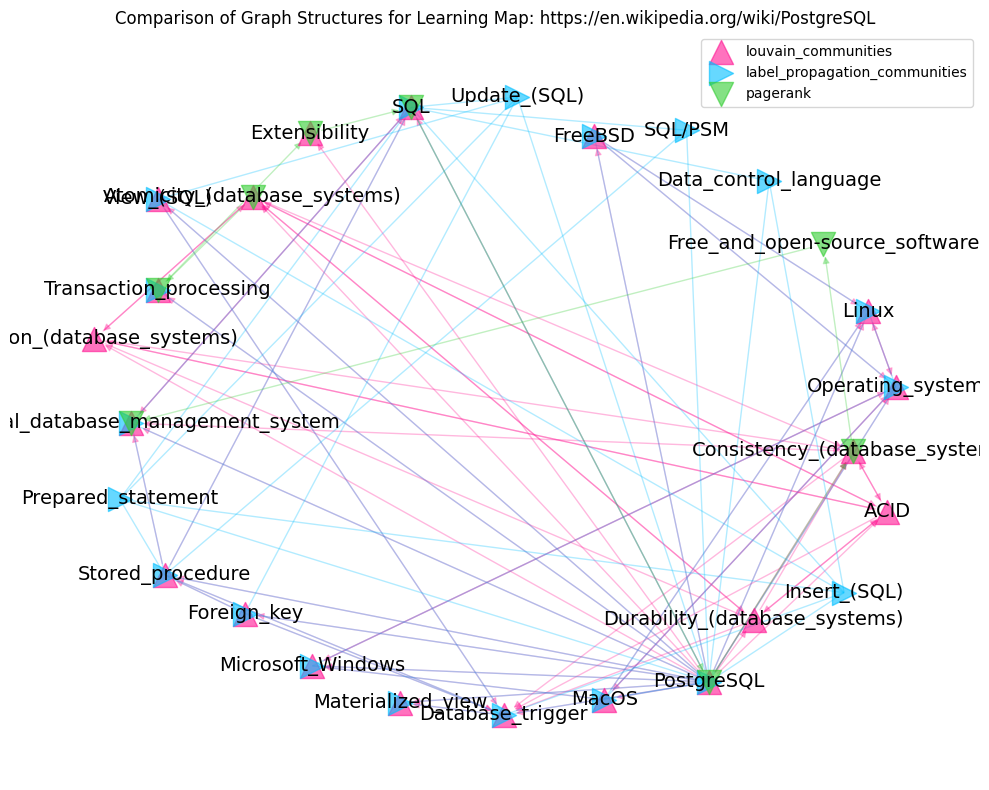

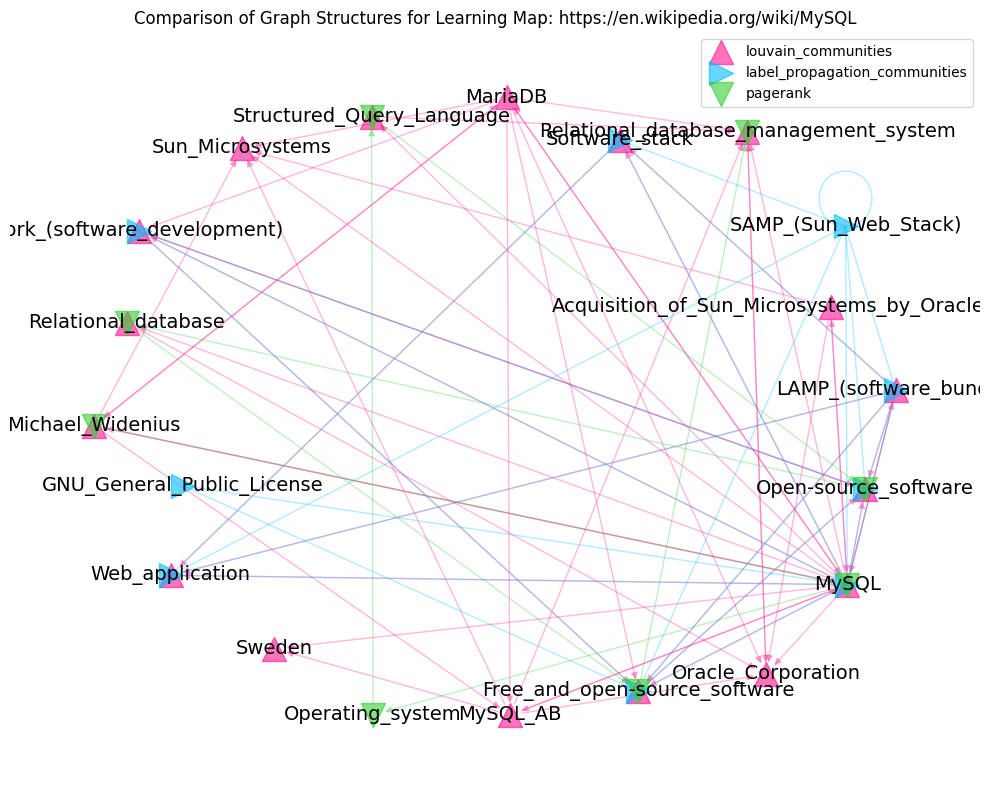

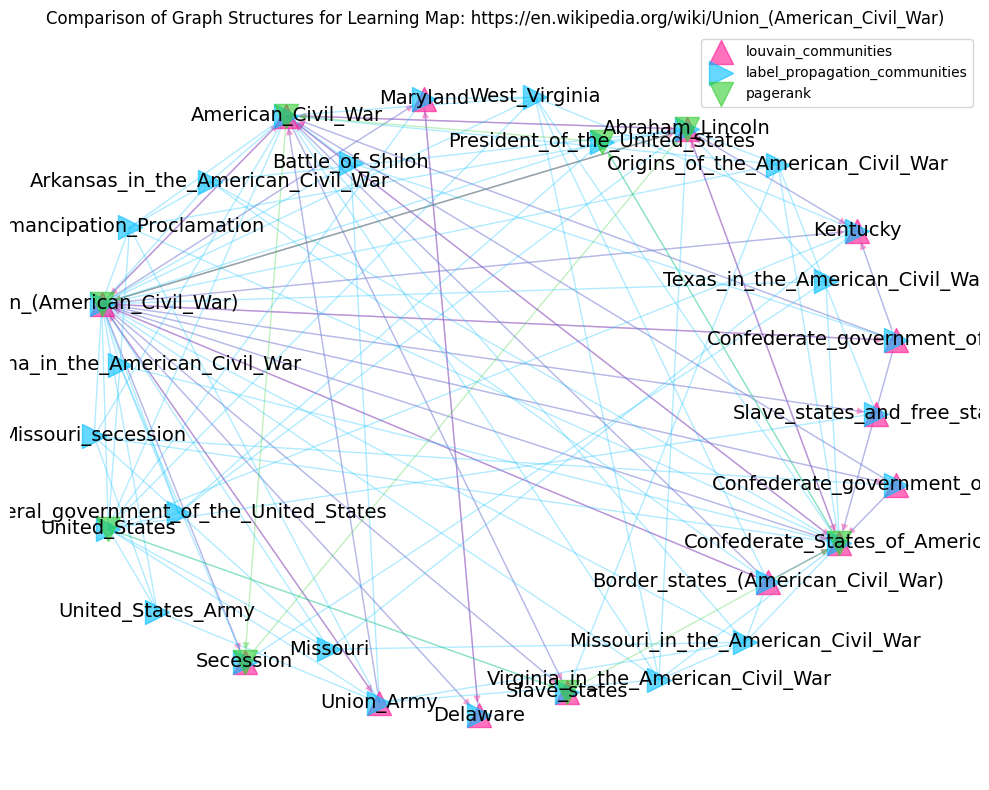

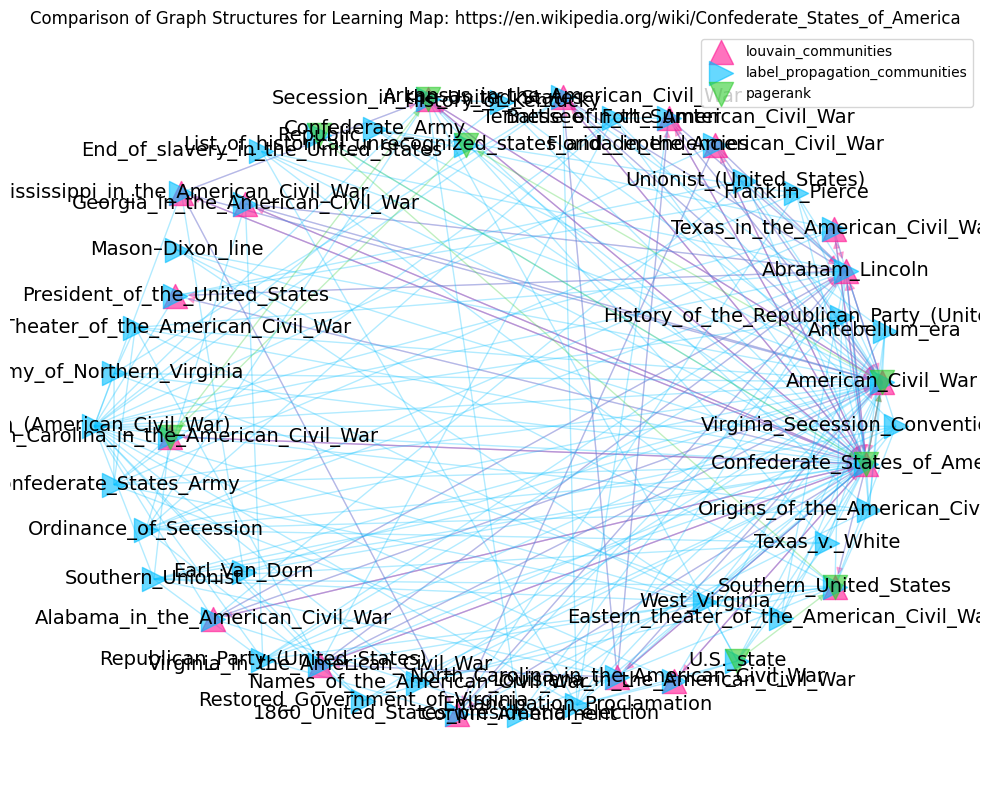

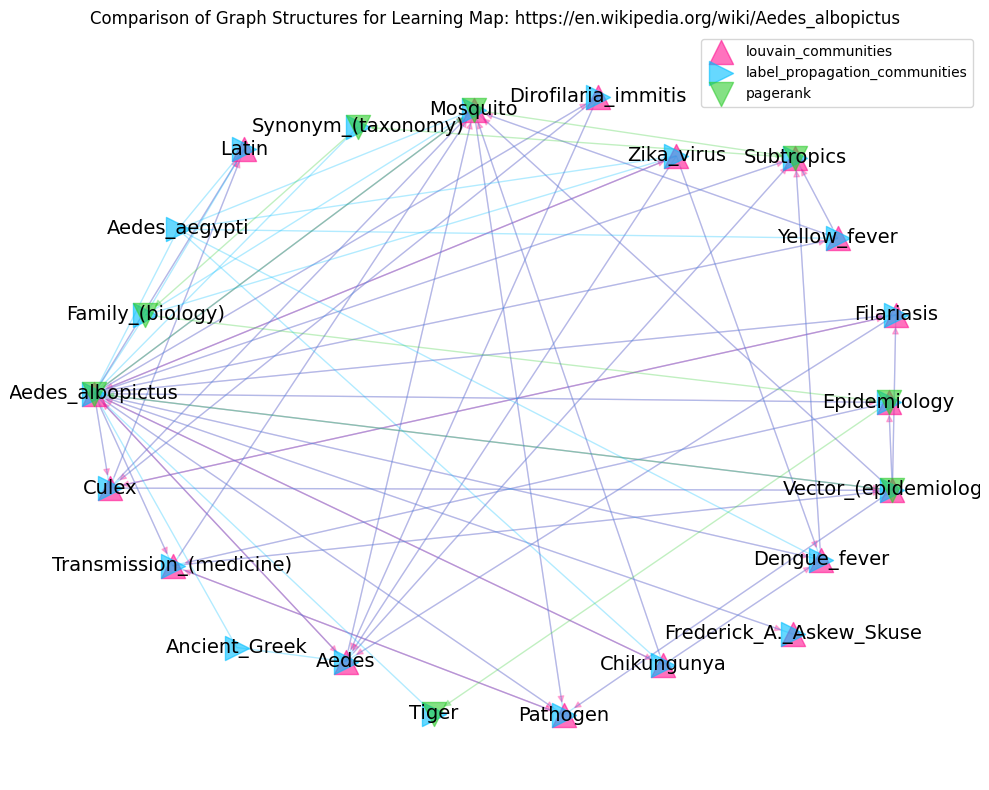

...

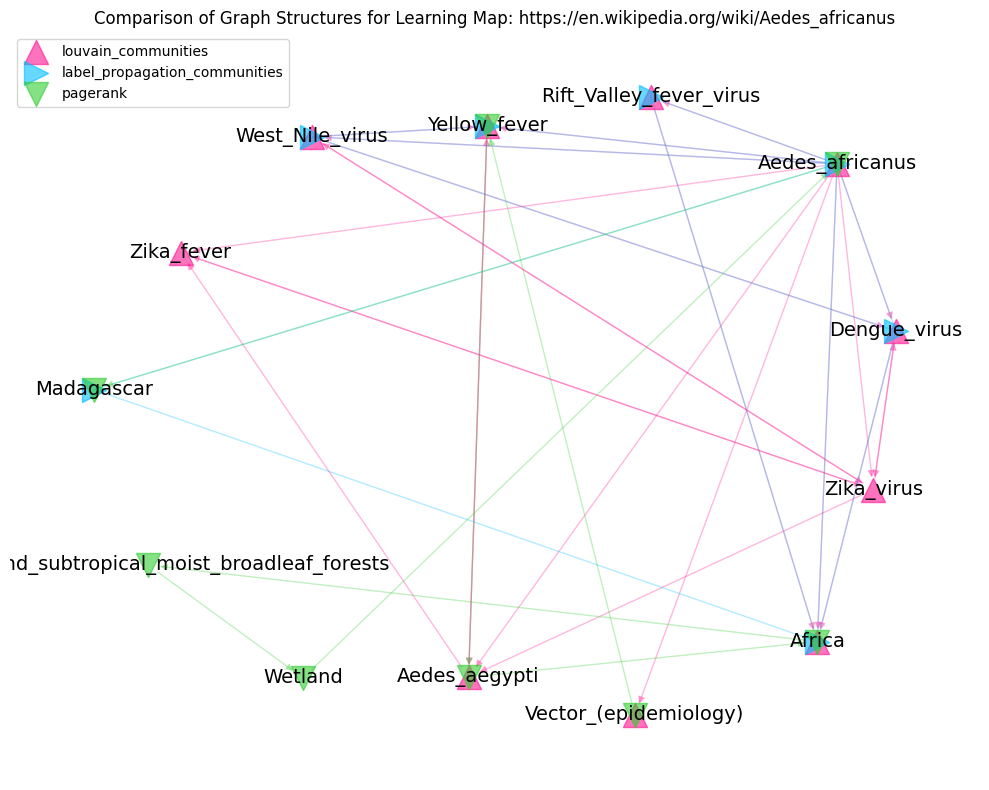

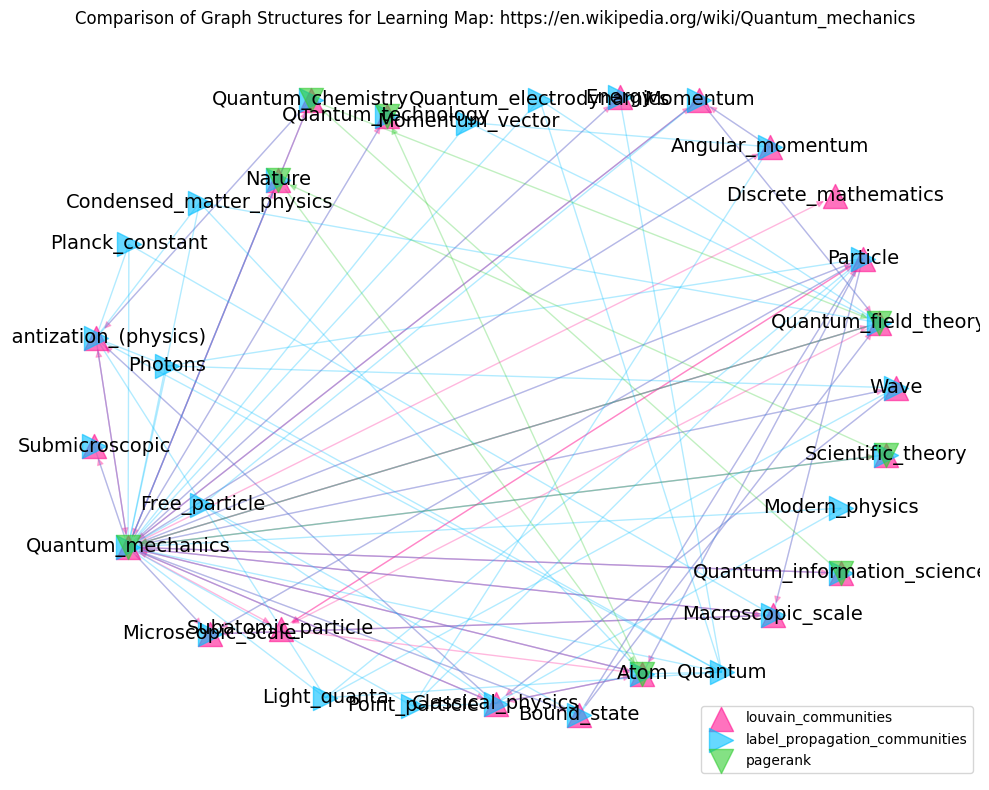

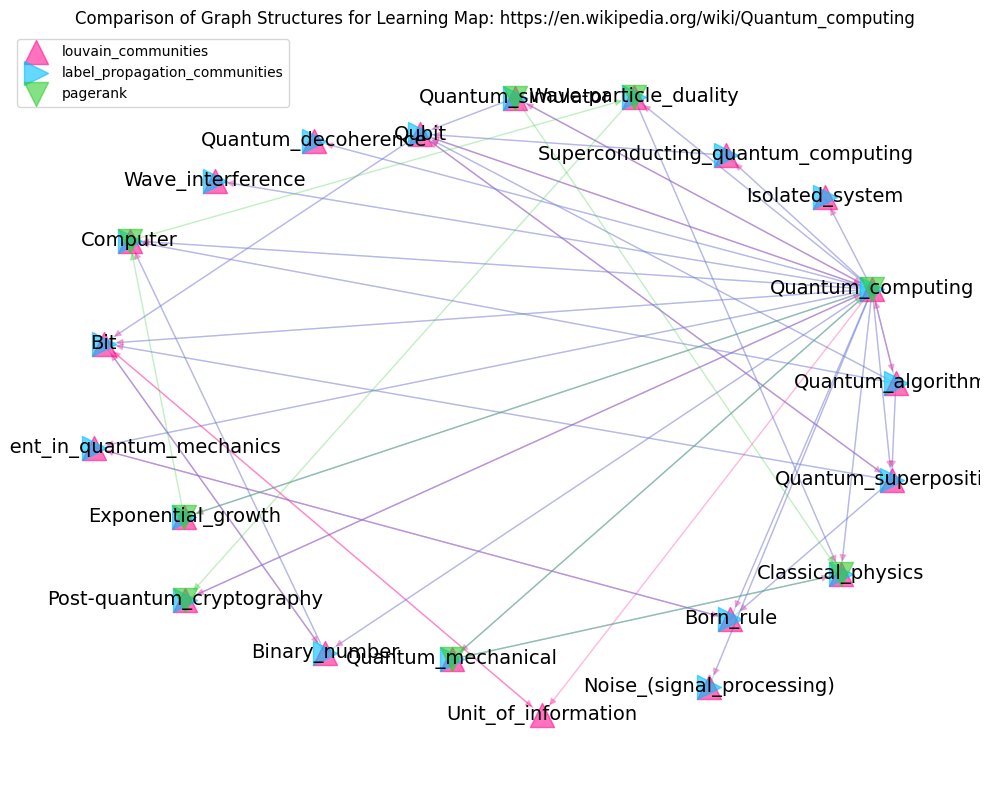

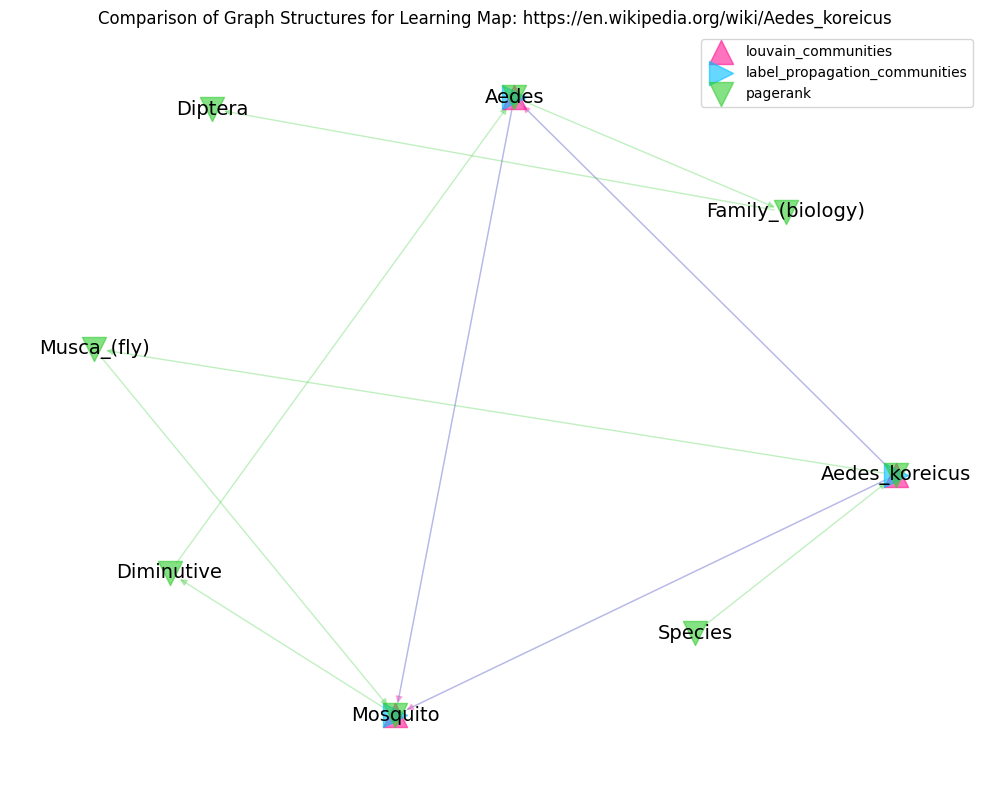

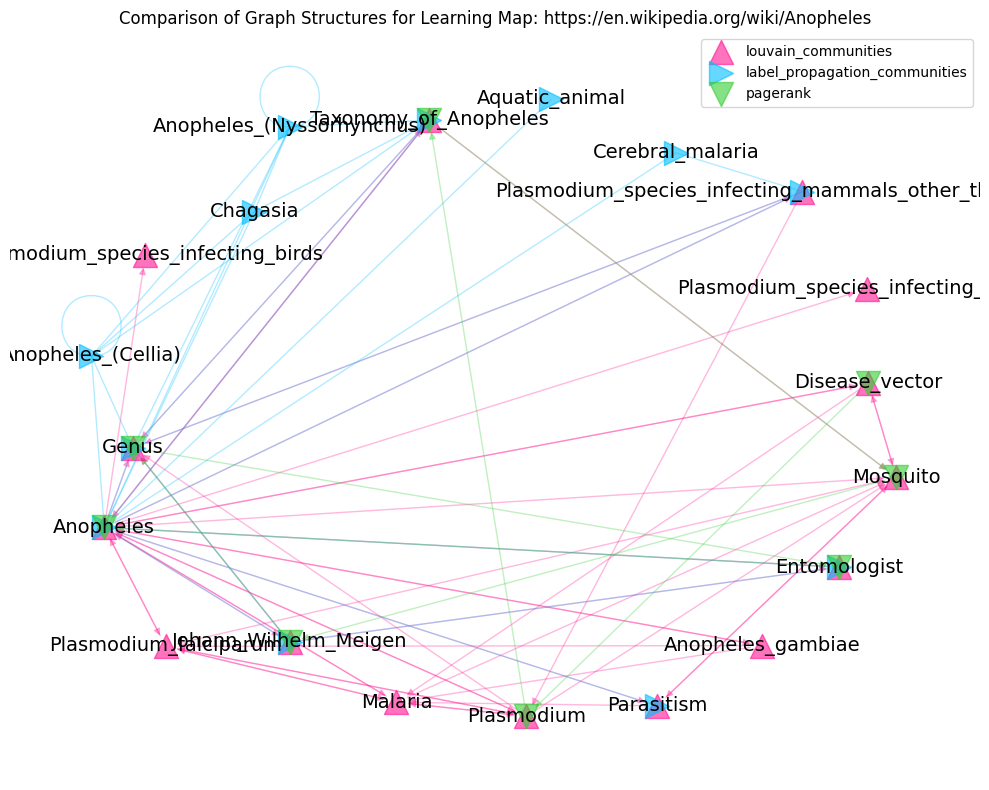

In [5]:
for learning_map, graphs in graph_data_comparison.items():
    # Plot and compare graphs head on rather than to a base one
    compare_graphs(graphs, learning_map, figsize=(10, 8), font_size=14)

In [6]:
# counted_learning_journeys = {}

# for learning_map, graphs in graph_data_comparison.items():
#     journey_key = learning_map.replace(f"https://{SUBECT_PREFIX}.wikipedia.org/wiki/", "")
#     counted_learning_journeys[link].append({
#         journey_key: get_page_views(journey_key, days=365*5)
#     })
#     for method_name, graph in graphs.items():
        
#         get_page_views(journey_key, days=365*5)
#         plot_single_graph(graph, f"{learning_map} using {method_name}", figsize=(10, 8), font_size=14)

In [7]:
size = {
    0: [],
    1: [],
    2: [],
}

for i, value in enumerate(size_of_methods["louvain_communities"]):
    size[i % 3].append(value)

2024-12-01 08:39:07,582 - matplotlib.category - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


2024-12-01 08:39:07,586 - matplotlib.category - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-12-01 08:39:07,659 - matplotlib.category - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-12-01 08:39:07,662 - matplotlib.category - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


/var/folders/cn/h1dncc4s0g771b7t4hy7y_000000gn/T/ipykernel_69754/1451893206.py:24: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(x='Path Length', y='Node Count', data=df_melted, estimator=np.mean, ci=None, color='red', markers='D', scale=0.7, ax=ax, linestyle="none")
/var/folders/cn/h1dncc4s0g771b7t4hy7y_000000gn/T/ipykernel_69754/1451893206.py:24: UserWarning: 

The `scale` parameter is deprecated and will be removed in v0.15.0. You can now control the size of each plot element using matplotlib `Line2D` parameters (e.g., `linewidth`, `markersize`, etc.).

  sns.pointplot(x='Path Length', y='Node Count', data=df_melted, estimator=np.mean, ci=None, color='red', markers='D', scale=0.7, ax=ax, linestyle="none")


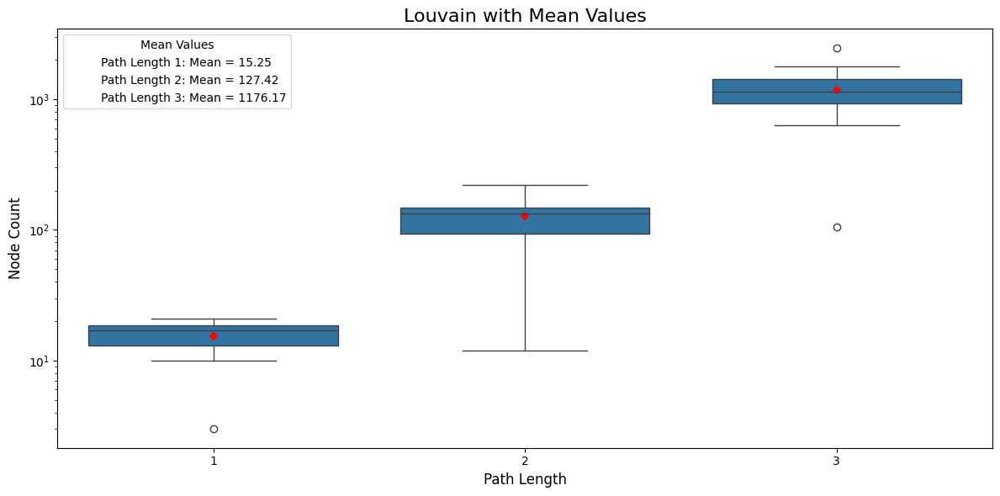

In [8]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Your data
data = size
data = {k+1: v for k, v in data.items()}

# Convert the data to a DataFrame
df = pd.DataFrame(data)

# Melt the DataFrame to create a long-format DataFrame
df_melted = df.melt(var_name='Path Length', value_name='Node Count')

# Create the box plot
plt.figure(figsize=(12, 6))
ax = sns.boxplot(x='Path Length', y='Node Count', data=df_melted)

# Calculate mean values for each category
means = df_melted.groupby('Path Length')['Node Count'].mean()

# Add mean markers to the plot
sns.pointplot(x='Path Length', y='Node Count', data=df_melted, estimator=np.mean, ci=None, color='red', markers='D', scale=0.7, ax=ax, linestyle="none")

# Customize the plot
plt.title('Louvain with Mean Values', fontsize=16)
plt.xlabel('Path Length', fontsize=12)
plt.ylabel('Node Count', fontsize=12)

# Adjust y-axis scale to logarithmic for better visualization
plt.yscale('log')

# Create legend entries
legend_elements = [plt.Line2D([0], [0], color='w', label=f'Path Length {cat}: Mean = {mean:.2f}',
                              markerfacecolor='red', markersize=0)
                   for cat, mean in means.items()]

# Add the legend
plt.legend(handles=legend_elements, title='Mean Values', loc='upper left')

# Adjust layout to make room for the legend
plt.tight_layout()

# Show the plot
plt.show()

In [9]:
size = {
    0: [],
    1: [],
    2: [],
}

for i, value in enumerate(size_of_methods["label_propagation_communities"]):
    size[i % 3].append(value)

2024-12-01 08:39:07,890 - matplotlib.category - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-12-01 08:39:07,893 - matplotlib.category - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-12-01 08:39:07,908 - matplotlib.category - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
2024-12-01 08:39:07,910 - matplotlib.category - INFO - Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.


/var/folders/cn/h1dncc4s0g771b7t4hy7y_000000gn/T/ipykernel_69754/1725355236.py:24: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.pointplot(x='Path Length', y='Node Count', data=df_melted, estimator=np.mean, ci=None, color='red', markers='D', scale=0.7, ax=ax, linestyle="none")
/var/folders/cn/h1dncc4s0g771b7t4hy7y_000000gn/T/ipykernel_69754/1725355236.py:24: UserWarning: 

The `scale` parameter is deprecated and will be removed in v0.15.0. You can now control the size of each plot element using matplotlib `Line2D` parameters (e.g., `linewidth`, `markersize`, etc.).

  sns.pointplot(x='Path Length', y='Node Count', data=df_melted, estimator=np.mean, ci=None, color='red', markers='D', scale=0.7, ax=ax, linestyle="none")


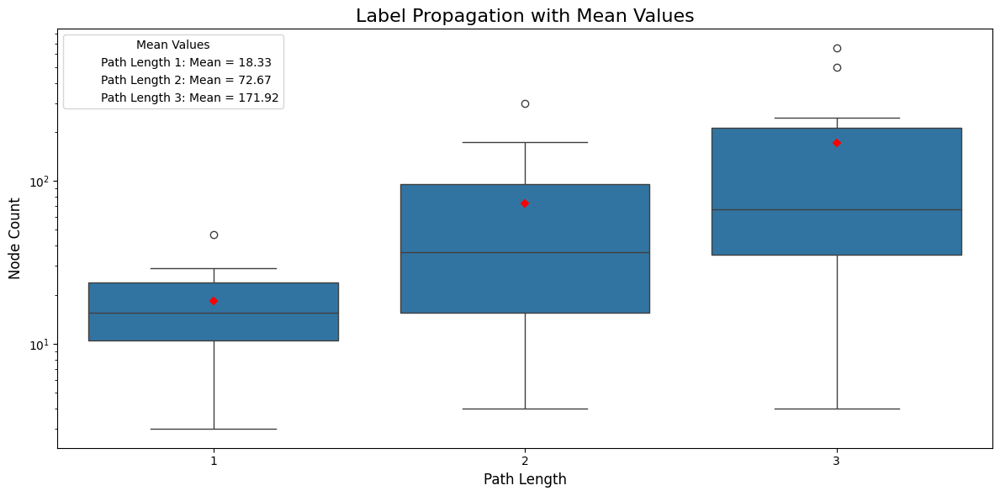

In [10]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Your data
data = size
data = {k+1: v for k, v in data.items()}

# Convert the data to a DataFrame
df = pd.DataFrame(data)

# Melt the DataFrame to create a long-format DataFrame
df_melted = df.melt(var_name='Path Length', value_name='Node Count')

# Create the box plot
plt.figure(figsize=(12, 6))
ax = sns.boxplot(x='Path Length', y='Node Count', data=df_melted)

# Calculate mean values for each category
means = df_melted.groupby('Path Length')['Node Count'].mean()

# Add mean markers to the plot
sns.pointplot(x='Path Length', y='Node Count', data=df_melted, estimator=np.mean, ci=None, color='red', markers='D', scale=0.7, ax=ax, linestyle="none")

# Customize the plot
plt.title('Label Propagation with Mean Values', fontsize=16)
plt.xlabel('Path Length', fontsize=12)
plt.ylabel('Node Count', fontsize=12)

# Adjust y-axis scale to logarithmic for better visualization
plt.yscale('log')

# Create legend entries
legend_elements = [plt.Line2D([0], [0], color='w', label=f'Path Length {cat}: Mean = {mean:.2f}',
                              markerfacecolor='red', markersize=0)
                   for cat, mean in means.items()]

# Add the legend
plt.legend(handles=legend_elements, title='Mean Values', loc='upper left')

# Adjust layout to make room for the legend
plt.tight_layout()

# Show the plot
plt.show()